<center> <font color = #82318E size = 5 face = "微软雅黑" > Visualization Final Homework Demo </font> </center>

In [1]:
import os
import numpy as np
from netCDF4 import Dataset

import imageio
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap

<center> <font color = #82318E size = 4 face = "微软雅黑" > 1. Scalar </font> </center>

<center> <font color = #82318E size = 3 face = "微软雅黑" > 1.1 Draw Test </font> </center>

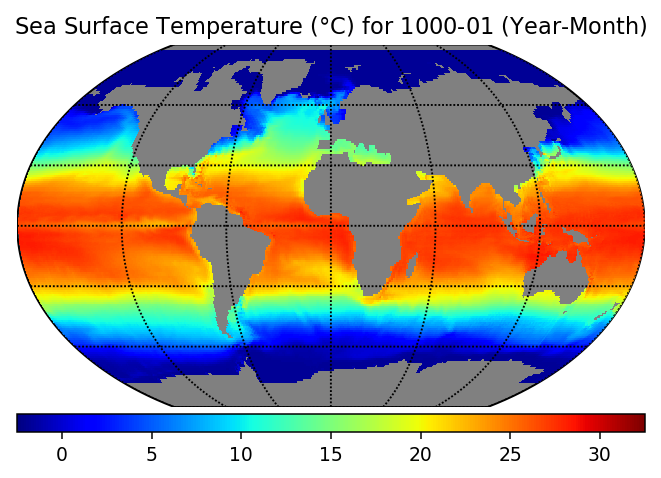

In [3]:
DPI = 135
dataset = Dataset('./Data/MMEAN1000-01.nc')

sst = dataset.variables['ts'][0, 0, ::, ::]

lats = dataset.variables['lat'][::]
lons = dataset.variables['lon'][::]

fig = plt.figure(dpi = DPI)
ax = fig.add_subplot(1, 1, 1)

lons, lats = np.meshgrid(lons, lats)
m = Basemap(projection = 'kav7', lon_0 = 0, resolution = None)
m.drawmapboundary(fill_color = '0.5')

scalar = m.pcolormesh(lons, lats, sst, shading = 'flat', norm = plt.Normalize(-2.5, 32.5),
                      cmap = plt.cm.jet, latlon = True)

m.drawparallels(np.arange(-90., 90., 30.))
m.drawmeridians(np.arange(-180., 180., 60.))
m.colorbar(scalar, 'bottom', size = '5%', pad = '2%')

ax.set_title('Sea Surface Temperature ($\degree$C) for {0:04d}-{1:02d} (Year-Month)'.format(1000, 1))

plt.savefig('./ScalarGIF/{0:04d}-{1:02d}.png'.format(1000, 1))
plt.show()

<center> <font color = #82318E size = 3 face = "微软雅黑" > 1.2 Define Function </font> </center>

In [4]:
def TimeSeries(key, i, j):
    dataset = Dataset('./Data/MMEAN{0:04d}-{1:02d}.nc'.format(i, j))

    sst = dataset.variables[key][0, 0, ::, ::]

    lats = dataset.variables['lat'][::]
    lons = dataset.variables['lon'][::]

    fig = plt.figure(dpi = DPI)
    ax = fig.add_subplot(1, 1, 1)

    lons, lats = np.meshgrid(lons,lats)
    m = Basemap(projection = 'kav7', lon_0 = 0, resolution = None)
    m.drawmapboundary(fill_color = '0.5')

    scalar = m.pcolormesh(lons, lats, sst, shading = 'flat', norm = plt.Normalize(-2.5, 32.5),
                      cmap = plt.cm.jet, latlon = True)

    m.drawparallels(np.arange(-90., 90., 30.))
    m.drawmeridians(np.arange(-180., 180., 60.))
    m.colorbar(scalar, 'bottom', size = '5%', pad = '2%')

    ax.set_title('Sea Surface Temperature ($\degree$C) for {0:04d}-{1:02d} (Year-Month)'.format(i, j))

    plt.savefig('./ScalarGIF/{0:04d}-{1:02d}.png'.format(i, j))
    plt.show()

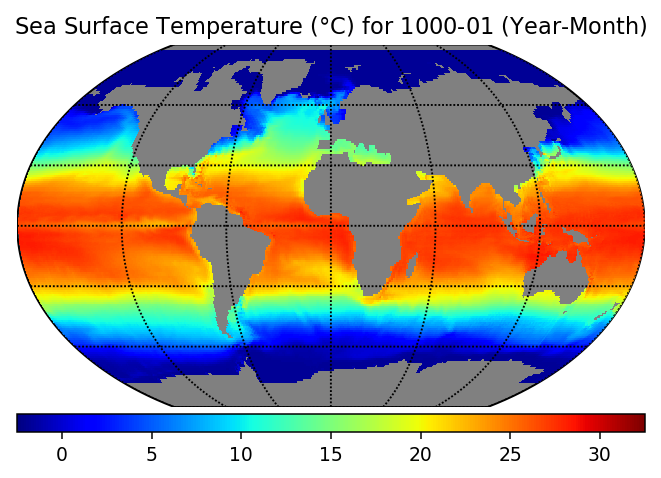

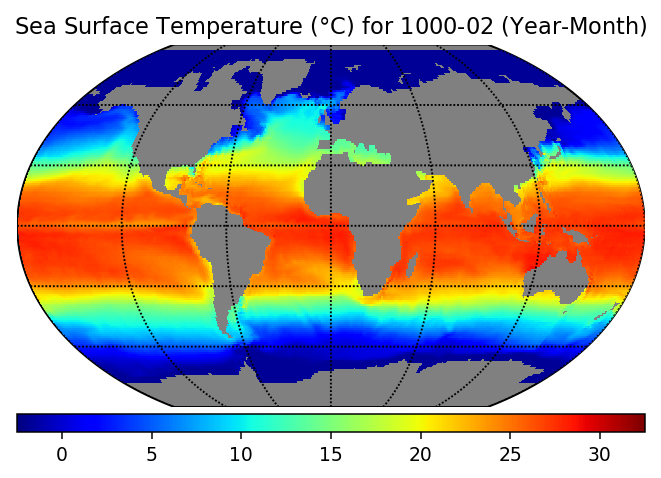

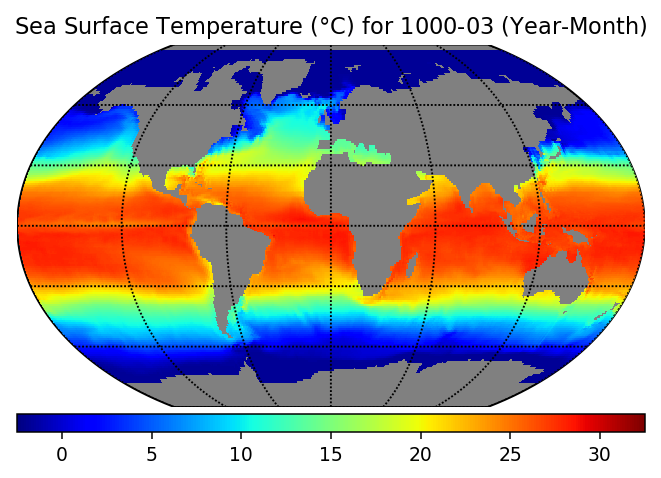

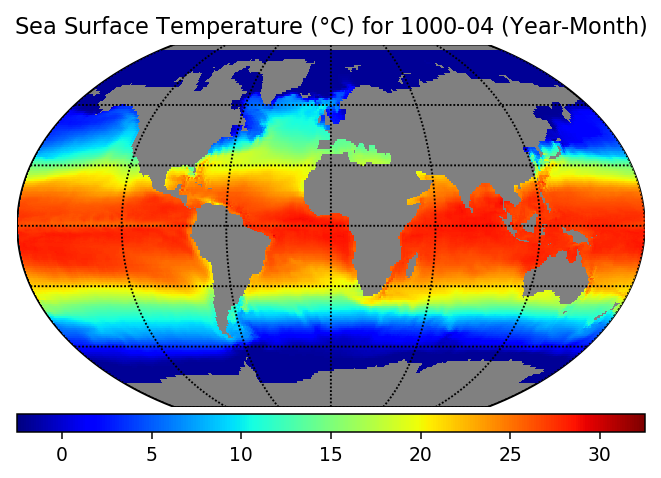

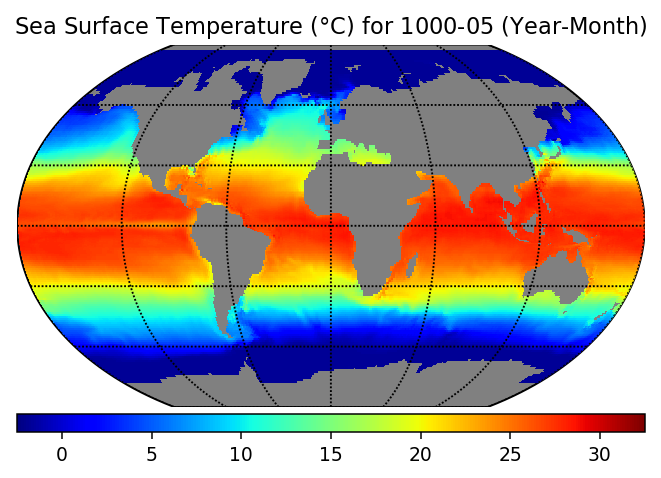

...

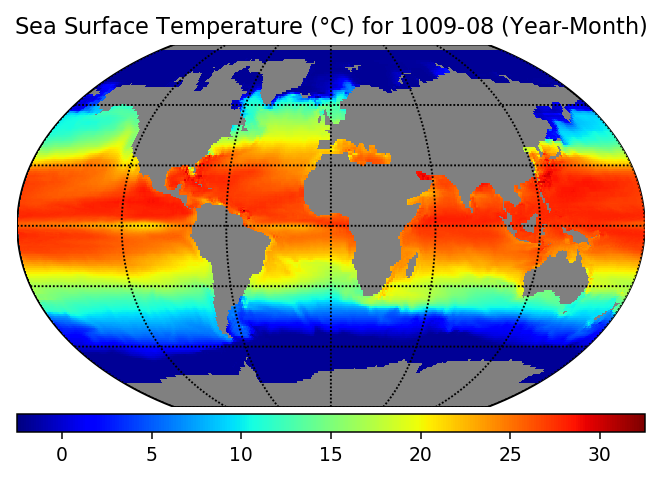

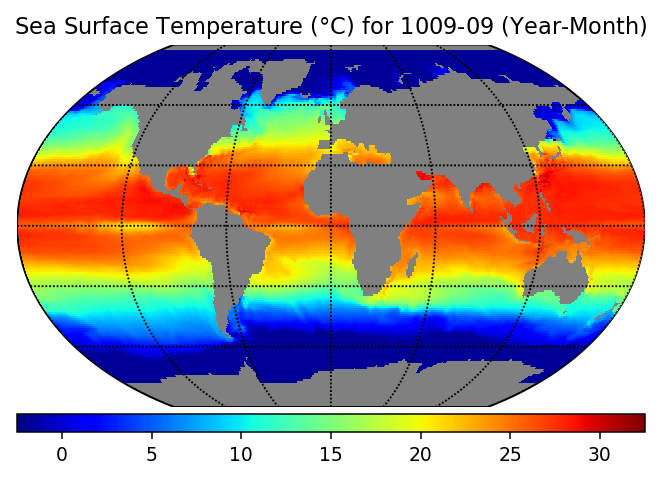

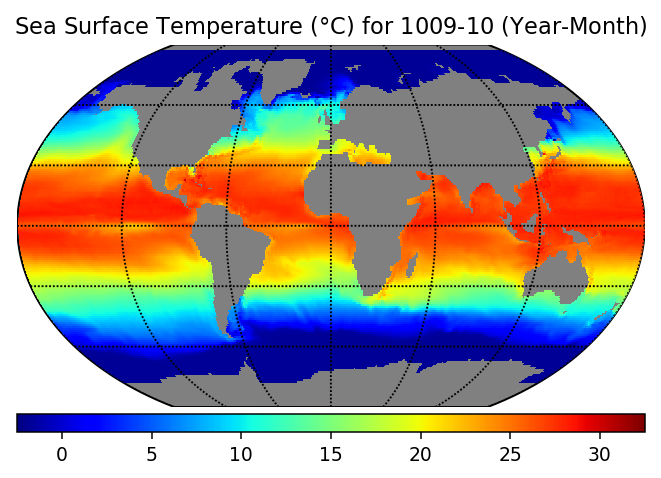

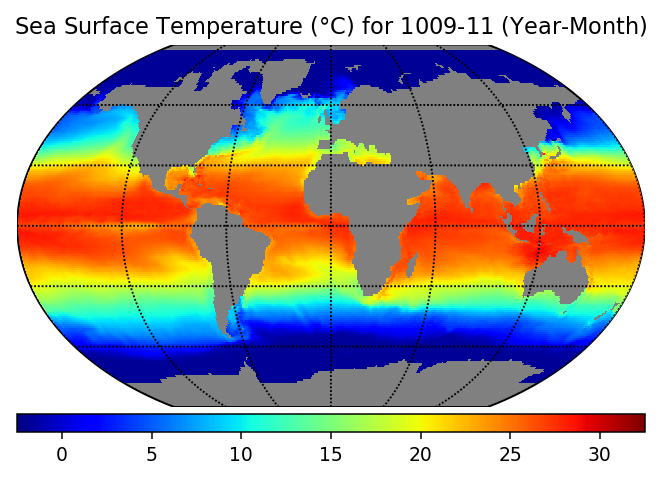

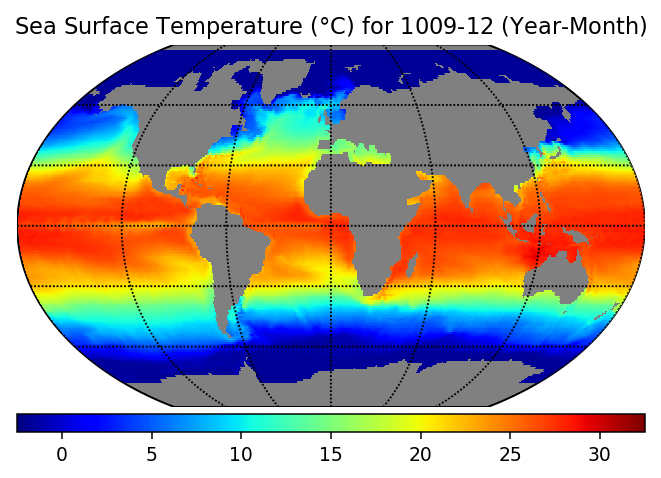

In [5]:
for i in np.arange(1000, 1010, 1):
    for j in np.arange(1, 13, 1):
        TimeSeries('ts', i, j)

<center> <font color = #82318E size = 3 face = "微软雅黑" > 1.4 GIF </font> </center>

In [6]:
def create_gif(image_list, gif_name):
 
    frames = list()
    for image_name in image_list:
        frames.append(imageio.imread(image_name))

    imageio.mimsave(gif_name, frames, 'GIF', duration = 0.2)
    
    return
 

dir = './ScalarGIF/'
gif_name = './ScalarCombination.gif'

image_list = list()
for file_name in os.listdir(dir):

    if file_name.split('.')[-1] == 'png':
        image_list.append(dir + file_name)
print(os.listdir(dir))

create_gif(image_list, gif_name)

['1000-01.png', '1000-02.png', '1000-03.png', '1000-04.png', '1000-05.png', '1000-06.png', '1000-07.png', '1000-08.png', '1000-09.png', '1000-10.png', '1000-11.png', '1000-12.png', '1001-01.png', '1001-02.png', '1001-03.png', '1001-04.png', '1001-05.png', '1001-06.png', '1001-07.png', '1001-08.png', '1001-09.png', '1001-10.png', '1001-11.png', '1001-12.png', '1002-01.png', '1002-02.png', '1002-03.png', '1002-04.png', '1002-05.png', '1002-06.png', '1002-07.png', '1002-08.png', '1002-09.png', '1002-10.png', '1002-11.png', '1002-12.png', '1003-01.png', '1003-02.png', '1003-03.png', '1003-04.png', '1003-05.png', '1003-06.png', '1003-07.png', '1003-08.png', '1003-09.png', '1003-10.png', '1003-11.png', '1003-12.png', '1004-01.png', '1004-02.png', '1004-03.png', '1004-04.png', '1004-05.png', '1004-06.png', '1004-07.png', '1004-08.png', '1004-09.png', '1004-10.png', '1004-11.png', '1004-12.png', '1005-01.png', '1005-02.png', '1005-03.png', '1005-04.png', '1005-05.png', '1005-06.png', '1005-07.

<center> <font color = #82318E size = 4 face = "微软雅黑" > 2. Streamline </font> </center>

<center> <font color = #82318E size = 3 face = "微软雅黑" > 2.1 Draw Test </font> </center>

(196, 362) (196, 362)


/Users/tsinghuafangzheng/anaconda/lib/python3.6/site-packages/numpy/ma/core.py:6592: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)
/Users/tsinghuafangzheng/anaconda/lib/python3.6/site-packages/ipykernel_launcher.py:20: RuntimeWarning: invalid value encountered in sqrt


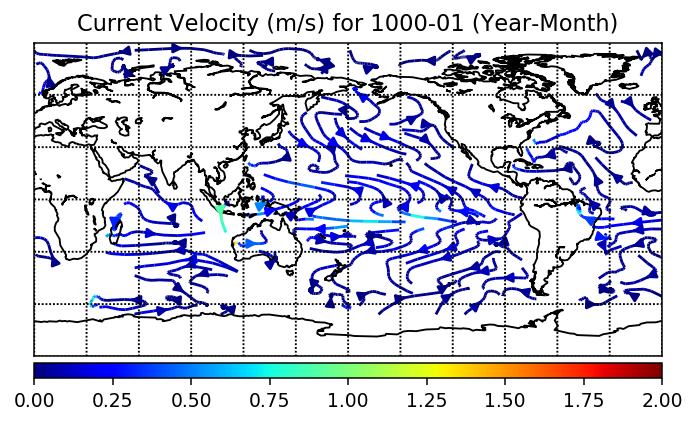

In [7]:
dataset = Dataset('./Data/MMEAN1000-01.nc')

lats = dataset.variables['lat'][::]
lons = dataset.variables['lon'][::]
lons, lats = np.meshgrid(lons,lats)

u = dataset.variables['us'][0, 0, ::, ::]
v = dataset.variables['vs'][0, 0, ::, ::]
print(u.shape, v.shape)
u[156:196:, ::] = 0
v[156:196:, ::] = 0

fig = plt.figure(dpi = DPI)
ax = fig.add_subplot(1, 1, 1)


m = Basemap(projection = 'cyl', lon_0 = 180)

vector = m.streamplot(lons, lats, u, v, latlon = False, norm = plt.Normalize(-0., 2.),
                      color = np.sqrt(u**2 + v**2), density = [1.5, 1.5], cmap = plt.cm.jet)
m.colorbar(vector.lines, 'bottom', size = '5%', pad = '2%')

m.drawcoastlines()
m.drawmeridians(np.arange(0, 360, 30))
m.drawparallels(np.arange(-90, 90, 30))

ax.set_title('Current Velocity (m/s) for {0:04d}-{1:02d} (Year-Month)'.format(1000, 1))

plt.savefig('./VectorGIFStreamline/{0:04d}-{1:02d}.png'.format(1000, 1))

plt.show()

<center> <font color = #82318E size = 3 face = "微软雅黑" > 2.2 Define Function </font> </center>

In [8]:
def TimeSeries(i, j):
    dataset = Dataset('./Data/MMEAN{0:04d}-{1:02d}.nc'.format(i, j))

    lats = dataset.variables['lat'][::]
    lons = dataset.variables['lon'][::]
    lons, lats = np.meshgrid(lons,lats)

    u = dataset.variables['us'][0, 0, ::, ::]
    v = dataset.variables['vs'][0, 0, ::, ::]
    u[156:196:, ::] = 0
    v[156:196:, ::] = 0

    fig = plt.figure(dpi = DPI)
    ax = fig.add_subplot(1, 1, 1)


    m = Basemap(projection = 'cyl', lon_0 = 180)

    vector = m.streamplot(lons, lats, u, v, latlon = False, norm = plt.Normalize(-0., 2.),
                          color = np.sqrt(u**2 + v**2), density = [1.5, 1.5], cmap = plt.cm.jet)
    m.colorbar(vector.lines, 'bottom', size = '5%', pad = '2%')

    m.drawcoastlines()
    m.drawmeridians(np.arange(0, 360, 30))
    m.drawparallels(np.arange(-90, 90, 30))

    ax.set_title('Current Velocity (m/s) for {0:04d}-{1:02d} (Year-Month)'.format(i, j))

    plt.savefig('./VectorGIFStreamline/{0:04d}-{1:02d}.png'.format(i, j))

    plt.show()

/Users/tsinghuafangzheng/anaconda/lib/python3.6/site-packages/numpy/ma/core.py:6592: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)
/Users/tsinghuafangzheng/anaconda/lib/python3.6/site-packages/ipykernel_launcher.py:20: RuntimeWarning: invalid value encountered in sqrt


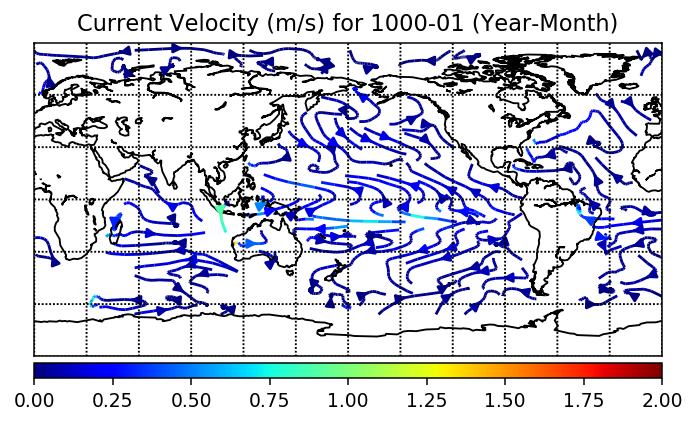

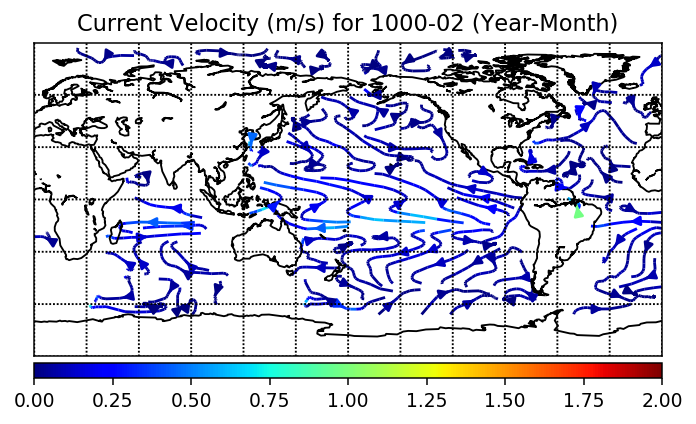

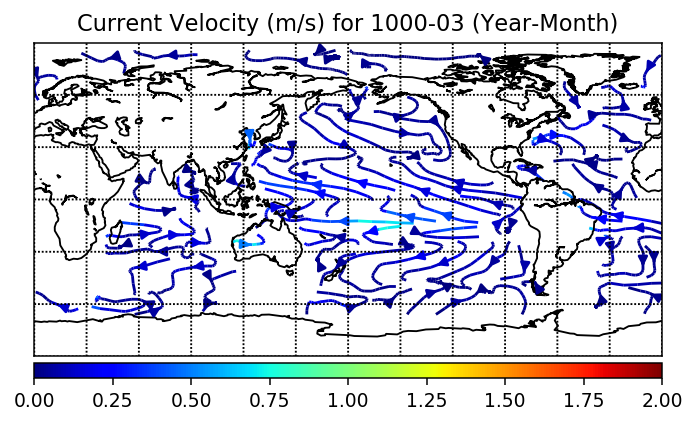

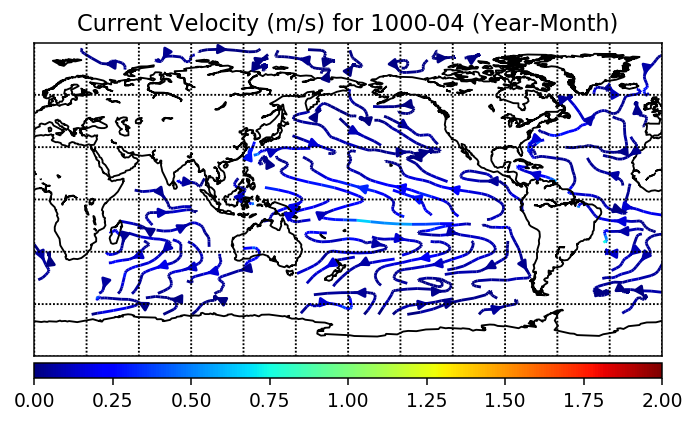

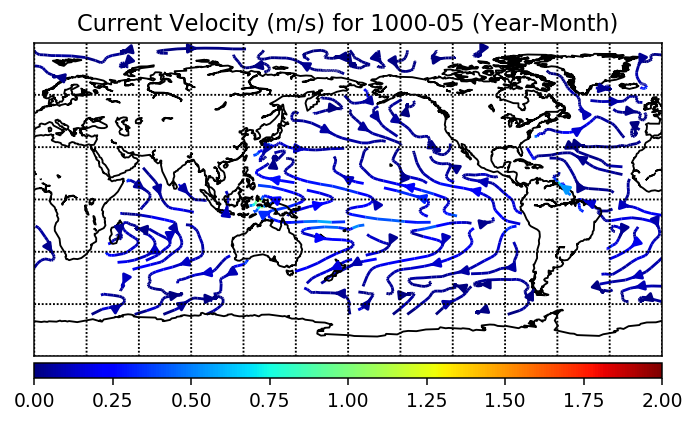

...

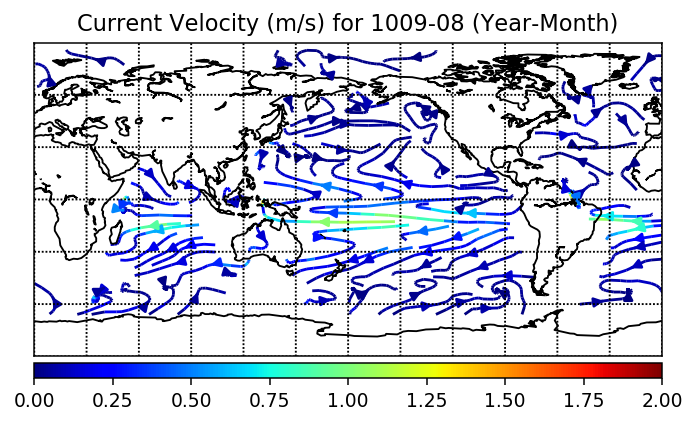

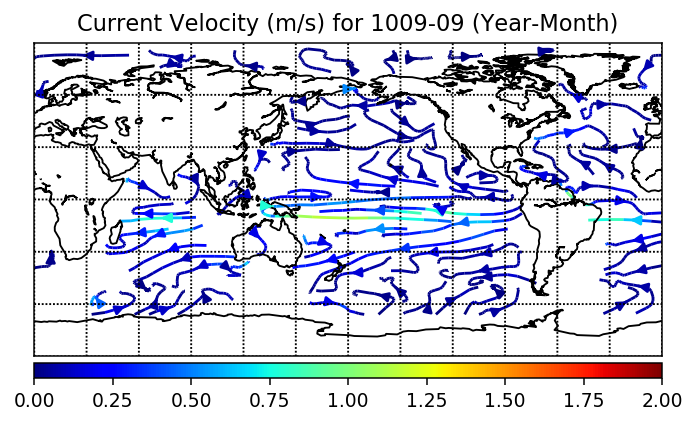

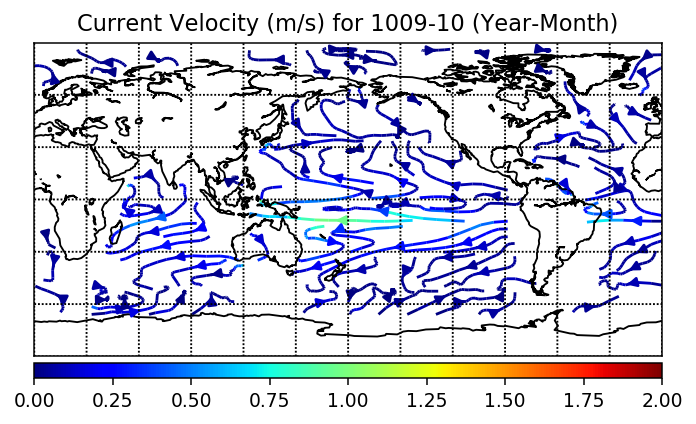

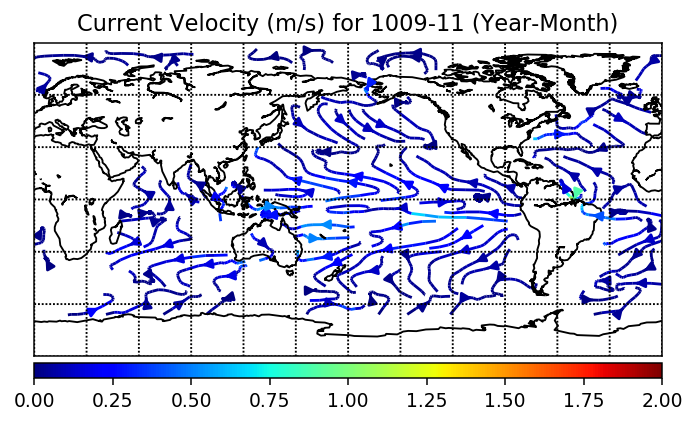

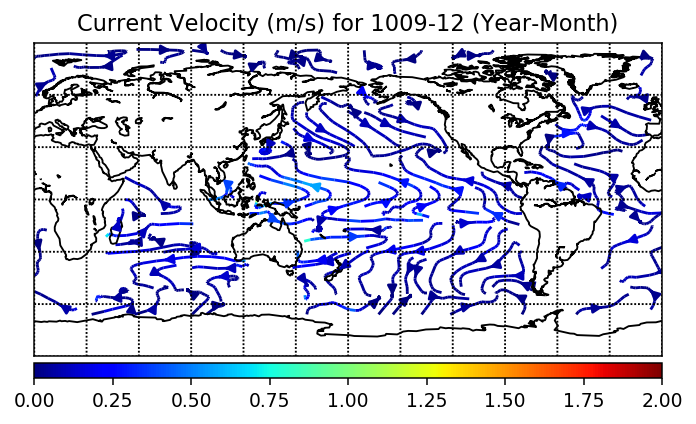

In [9]:
for i in np.arange(1000, 1010, 1):
    for j in np.arange(1, 13, 1):
        TimeSeries(i, j)

<center> <font color = #82318E size = 3 face = "微软雅黑" > 2.3 GIF </font> </center>

In [83]:
dir = './VectorGIFStreamline/'
gif_name = './VectorStreamlineCombination.gif'

image_list = list()
for file_name in os.listdir(dir):

    if file_name.split('.')[-1] == 'png':
        image_list.append(dir + file_name)
print(os.listdir(dir))

create_gif(image_list, gif_name)

['1000-01.png', '1000-02.png', '1000-03.png', '1000-04.png', '1000-05.png', '1000-06.png', '1000-07.png', '1000-08.png', '1000-09.png', '1000-10.png', '1000-11.png', '1001-01.png', '1001-02.png', '1001-03.png', '1001-04.png', '1001-05.png', '1001-06.png', '1001-07.png', '1001-08.png', '1001-09.png', '1001-10.png', '1001-11.png', '1002-01.png', '1002-02.png', '1002-03.png', '1002-04.png', '1002-05.png', '1002-06.png', '1002-07.png', '1002-08.png', '1002-09.png', '1002-10.png', '1002-11.png', '1003-01.png', '1003-02.png', '1003-03.png', '1003-04.png', '1003-05.png', '1003-06.png', '1003-07.png', '1003-08.png', '1003-09.png', '1003-10.png', '1003-11.png', '1004-01.png', '1004-02.png', '1004-03.png', '1004-04.png', '1004-05.png', '1004-06.png', '1004-07.png', '1004-08.png', '1004-09.png', '1004-10.png', '1004-11.png', '1005-01.png', '1005-02.png', '1005-03.png', '1005-04.png', '1005-05.png', '1005-06.png', '1005-07.png', '1005-08.png', '1005-09.png', '1005-10.png', '1005-11.png', '1006-01.

<center> <font color = #82318E size = 4 face = "微软雅黑" > 3. Arrow </font> </center>

<center> <font color = #82318E size = 3 face = "微软雅黑" > 3.1 Draw Test </font> </center>

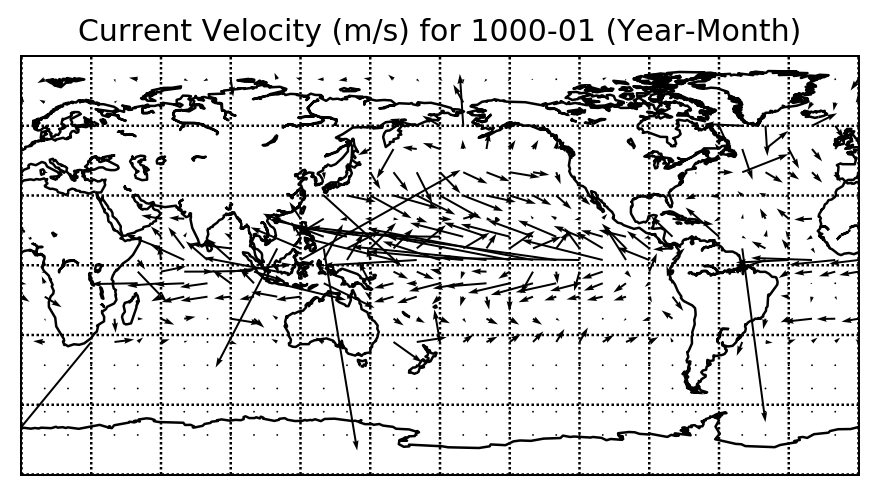

In [2]:
dataset = Dataset('./Data/MMEAN1000-01.nc')

lats = dataset.variables['lat'][::]
lons = dataset.variables['lon'][::]
lons, lats = np.meshgrid(lons,lats)

u = dataset.variables['us'][0, 0, ::, ::]
v = dataset.variables['vs'][0, 0, ::, ::]
u[156:196:, ::] = 0
v[156:196:, ::] = 0

fig = plt.figure(dpi = 180)
ax = fig.add_subplot(1, 1, 1)


m = Basemap(projection = 'cyl', lon_0 = 180)

skip = 10
vector = m.quiver(lons[::skip, ::skip], lats[::skip, ::skip],
                  u[::skip, ::skip], v[::skip, ::skip])

m.drawcoastlines()
m.drawmeridians(np.arange(0, 360, 30))
m.drawparallels(np.arange(-90, 90, 30))

ax.set_title('Current Velocity (m/s) for {0:04d}-{1:02d} (Year-Month)'.format(1000, 1))

plt.savefig('./VectorGIFArrow/{0:04d}-{1:02d}.png'.format(1000, 1))

plt.show()

In [ ]:
def TimeSeries(i, j):
    dataset = Dataset('./Data/MMEAN{0:04d}-{1:02d}.nc'.format(i, j))

    lats = dataset.variables['lat'][::]
    lons = dataset.variables['lon'][::]
    lons, lats = np.meshgrid(lons,lats)

    u = dataset.variables['us'][0, 0, ::, ::]
    v = dataset.variables['vs'][0, 0, ::, ::]
    u[156:196:, ::] = 0
    v[156:196:, ::] = 0

    fig = plt.figure(dpi = 180)
    ax = fig.add_subplot(1, 1, 1)


    m = Basemap(projection = 'cyl', lon_0 = 180)

    skip = 10
    vector = m.quiver(lons[::skip, ::skip], lats[::skip, ::skip],
                      u[::skip, ::skip], v[::skip, ::skip])

    m.drawcoastlines()
    m.drawmeridians(np.arange(0, 360, 30))
    m.drawparallels(np.arange(-90, 90, 30))

    ax.set_title('Current Velocity (m/s) for {0:04d}-{1:02d} (Year-Month)'.format(1000, 1))

    plt.savefig('./VectorGIFArrow/{0:04d}-{1:02d}.png'.format(1000, 1))

    plt.show()

In [ ]:
for i in np.arange(1000, 1010, 1):
    for j in np.arange(1, 13, 1):
        TimeSeries(i, j)

In [ ]:
dir = './VectorGIFArrow/'
gif_name = './VectorStreamlineArrow.gif'

image_list = list()
for file_name in os.listdir(dir):

    if file_name.split('.')[-1] == 'png':
        image_list.append(dir + file_name)
print(os.listdir(dir))

create_gif(image_list, gif_name)